#### 자연어 처리
- Data 처리 단계 
    * 1) 수집
    * 2) 정제 및 토큰화
    * 3) 불용어 / 구두점 제거
    * 4) 단어 사전 => 토큰 : 숫자로 맵핑 진행
    * 5) 데이터의 수치화

[1] Module Loading 및 Data 준비 <hr>

In [1]:
# Module Loading
from nltk.tokenize import word_tokenize, sent_tokenize, wordpunct_tokenize

In [2]:
# Data 준비
TEXT_FILE = "../data/corpus_data.txt"

In [3]:
# File에서 Data 추출 => rt : File 읽기의 기본 Mode값
with open(TEXT_FILE, mode = "rt", encoding="utf-8") as f :
    
    # 읽을 Data size 지정한만큼 읽어옴 ex) read(100)이면 100개만 읽어옴
    text_data = f.read()            # read() 함수는 int로 결과를 냄 // 전체를 모두 읽어옴
    f.seek(0)                       # 마우스 커서 처음으로 이동 -> 내가 원하는 지점으로 이동 가능

In [4]:
# File에서 Data 추출 => rt : File 읽기의 기본 Mode값
# line 단위로 읽기 => readline()
with open(TEXT_FILE, mode = "rt", encoding="utf-8") as f :
    all_data = []
    while True :
        # 한줄씩 읽기 \n을 인식해서 ~ 
        text_data = f.readline()                # 전체를 읽을거면 while문 돌려야함 
        if not text_data :
            break
        else :
            all_data.append(text_data)

In [5]:
print(f"text_data => {len(text_data)}개, {text_data}")
print(f"all_data => {len(all_data)}개, {all_data}")

text_data => 0개, 
all_data => 149개, ['"The Tichborne Claimant" redirects here. For the 1998 film, see The Tichborne Claimant (film).\n', '\n', "The blended image (centre) was said by the Claimant's supporters to prove that Roger Tichborne (left, in 1853) and the Claimant (right, in 1874) were one and the same person.[n 1]\n", 'The Tichborne case was a legal cause célèbre that fascinated Victorian Britain in the 1860s and 1870s. It concerned the claims by a man sometimes referred to as Thomas Castro or as Arthur Orton, but usually termed "the Claimant", to be the missing heir to the Tichborne baronetcy. He failed to convince the courts, was convicted of perjury and served a 14-year prison sentence.\n', '\n', "Roger Tichborne, heir to the family's title and fortunes, was presumed to have died in a shipwreck in 1854 at age 25. His mother clung to a belief that he might have survived, and after hearing rumours that he had made his way to Australia, she advertised extensively in Australian 

<hr>

- 위에처럼 하는건 귀찮음 
- 한번에 전체 읽기 가능

In [6]:
# File에서 Data 추출 => rt : File 읽기의 기본 Mode값
# line 단위로 전체 읽기 => readlines()
with open(TEXT_FILE, mode = "rt", encoding="utf-8") as f :
    # 한줄씩 (\n) 전체 읽어서 리스트에 담아서 반환 
    text_data = f.readlines()             

In [7]:
print(f"text_data => {len(text_data)}개, {text_data}")
[print(text) for text in text_data]

## 결과값에 모두 \n이 들어가 있음

text_data => 149개, ['"The Tichborne Claimant" redirects here. For the 1998 film, see The Tichborne Claimant (film).\n', '\n', "The blended image (centre) was said by the Claimant's supporters to prove that Roger Tichborne (left, in 1853) and the Claimant (right, in 1874) were one and the same person.[n 1]\n", 'The Tichborne case was a legal cause célèbre that fascinated Victorian Britain in the 1860s and 1870s. It concerned the claims by a man sometimes referred to as Thomas Castro or as Arthur Orton, but usually termed "the Claimant", to be the missing heir to the Tichborne baronetcy. He failed to convince the courts, was convicted of perjury and served a 14-year prison sentence.\n', '\n', "Roger Tichborne, heir to the family's title and fortunes, was presumed to have died in a shipwreck in 1854 at age 25. His mother clung to a belief that he might have survived, and after hearing rumours that he had made his way to Australia, she advertised extensively in Australian newspapers, offer

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,

<hr>

- [2] Data 전처리 <hr>

- 줄바꿈 문자 (\n) 처리

In [8]:
# 현재 text_data의 상태 : "a\n", "\n", "c\n", ...., 이런 형식
#               => for문을 돌려 원소를 읽어와 \n을 제거 해야함
# 원소의 뒤에 \n이 있으므로 반대로 가져와야함 text_data[::-1] 
all_text = []

for text in text_data :
    text = text.replace("\n", "")
    if len(text) : all_text.append(text)

print(f"all_text => {len(all_text)}개")

all_text => 87개


- 대소문자 통일 

In [9]:
# ( a for a in b ) : 제너레이터(Generator) 생성
all_text = (text.lower() for text in all_text)

# 출력값 보기
# for _ in all_text :
#     print(_)

# -> for문을 해제하면 커서가 뒤로 이동해서 밑에 len 출력시 0으로 출력됨

In [10]:
# List  컨프레이션 ?
# all_text = [text.lower() for text in all_text]
# all_text

- 토큰화

In [11]:
all_tokens = []
for text in all_text :
    all_tokens.append(wordpunct_tokenize(text))

In [12]:
print(f"all_tokens => {len(all_tokens)}개")

all_tokens => 87개


- 불용어 & 구두점 제거

In [13]:
## 불용어 추출
## 구두점 추출
from nltk.corpus import stopwords
import string

eng_stopwords = stopwords.words("english")
pun = list(string.punctuation)

In [16]:
# 불용어, 구두점, 길이 짧은 토큰 제거 
for tokenList in all_tokens :
    # print(tokenList)
    for token in tokenList[::-1] :
        # 불용어인 경우 or 구두점인 경우 or 길이가 1~2인것들 
        if token.isnumeric():
            tokenList.remove(token)
        elif (token in eng_stopwords) or (token in pun) or (len(token) <= 2):
            tokenList.remove(token)

tokenList

['woodruff',
 'submits',
 'legal',
 'verdicts',
 'although',
 'fair',
 'given',
 'evidence',
 'courts',
 'fully',
 'resolved',
 'great',
 'doubt',
 'cockburn',
 'admitted',
 'hung',
 'case',
 'woodruff',
 'wrote',
 'probably',
 'ever',
 'key',
 'long',
 'since',
 'lost',
 '...',
 'mystery',
 'remains',
 '".[',
 'article',
 'catholic',
 'herald',
 'suggested',
 'dna',
 'profiling',
 'might',
 'resolve',
 'mystery',
 'enigma',
 'launched',
 'numerous',
 'retellings',
 'story',
 'book',
 'film',
 'including',
 'short',
 'story',
 'tom',
 'castro',
 'implausible',
 'imposter',
 'jorge',
 'luis',
 'borges',
 'universal',
 'history',
 'infamy',
 'david',
 'yates',
 'film',
 'tichborne',
 'claimant',
 'thus',
 'woodruff',
 'concludes',
 'man',
 'lost',
 'still',
 'walks',
 'history',
 'name',
 'common',
 'voice',
 'day',
 'accorded',
 'claimant',
 '".[']

In [66]:
for tokenList in all_tokens :
    print(tokenList)

['tichborne', 'claimant', 'redirects', '1998', 'film', 'see', 'tichborne', 'claimant', 'film']
['blended', 'image', 'centre', 'said', 'claimant', 'supporters', 'prove', 'roger', 'tichborne', 'left', '1853', 'claimant', 'right', '1874', 'one', 'person']
['tichborne', 'case', 'legal', 'cause', 'célèbre', 'fascinated', 'victorian', 'britain', '1860s', '1870s', 'concerned', 'claims', 'man', 'sometimes', 'referred', 'thomas', 'castro', 'arthur', 'orton', 'usually', 'termed', 'claimant', 'missing', 'heir', 'tichborne', 'baronetcy', 'failed', 'convince', 'courts', 'convicted', 'perjury', 'served', 'year', 'prison', 'sentence']
['roger', 'tichborne', 'heir', 'family', 'title', 'fortunes', 'presumed', 'died', 'shipwreck', '1854', 'age', 'mother', 'clung', 'belief', 'might', 'survived', 'hearing', 'rumours', 'made', 'way', 'australia', 'advertised', 'extensively', 'australian', 'newspapers', 'offering', 'reward', 'information', '1866', 'wagga', 'wagga', 'butcher', 'known', 'thomas', 'castro', 'c

- 단어별 빈도수 계산

In [72]:
# 토큰을 키로 해서 빈도수 저장
token_freqs = {}

# 라인(줄) 별 토큰을 읽어서 빈도 체크
for tokenList in all_tokens :
    for token in tokenList :
        # 토큰 키가 존재하지 않으면 키로 추가 후 1로 설정
        if token not in token_freqs :
            token_freqs[token] = 1
        # 이미 존재하는 토큰 키이면 값을 +1 증가
        else :
            token_freqs[token] += 1

In [71]:
token_freqs

{'tichborne': 97,
 'claimant': 115,
 'redirects': 1,
 'film': 4,
 'see': 1,
 'blended': 1,
 'image': 1,
 'centre': 2,
 'said': 5,
 'supporters': 8,
 'prove': 2,
 'roger': 62,
 'left': 6,
 'right': 2,
 'one': 13,
 'person': 2,
 'case': 23,
 'legal': 12,
 'cause': 3,
 'célèbre': 1,
 'fascinated': 1,
 'victorian': 1,
 'britain': 1,
 '1860s': 1,
 '1870s': 1,
 'concerned': 2,
 'claims': 2,
 'man': 4,
 'sometimes': 4,
 'referred': 1,
 'thomas': 8,
 'castro': 15,
 'arthur': 22,
 'orton': 41,
 'usually': 1,
 'termed': 1,
 'missing': 5,
 'heir': 4,
 'baronetcy': 4,
 'failed': 5,
 'convince': 3,
 'courts': 4,
 'convicted': 3,
 'perjury': 5,
 'served': 3,
 'year': 5,
 'prison': 3,
 'sentence': 4,
 'family': 32,
 'title': 3,
 'fortunes': 2,
 'presumed': 3,
 'died': 9,
 'shipwreck': 2,
 'age': 2,
 'mother': 6,
 'clung': 1,
 'belief': 3,
 'might': 6,
 'survived': 1,
 'hearing': 3,
 'rumours': 2,
 'made': 7,
 'way': 1,
 'australia': 13,
 'advertised': 1,
 'extensively': 1,
 'australian': 3,
 'newspap

In [76]:
# 빈도별로 몇개의 단어가 존재하는지 체크
token_freqs.items()

dict_items([('tichborne', 97), ('claimant', 115), ('redirects', 1), ('film', 4), ('see', 1), ('blended', 1), ('image', 1), ('centre', 2), ('said', 5), ('supporters', 8), ('prove', 2), ('roger', 62), ('left', 6), ('right', 2), ('one', 13), ('person', 2), ('case', 23), ('legal', 12), ('cause', 3), ('célèbre', 1), ('fascinated', 1), ('victorian', 1), ('britain', 1), ('1860s', 1), ('1870s', 1), ('concerned', 2), ('claims', 2), ('man', 4), ('sometimes', 4), ('referred', 1), ('thomas', 8), ('castro', 15), ('arthur', 22), ('orton', 41), ('usually', 1), ('termed', 1), ('missing', 5), ('heir', 4), ('baronetcy', 4), ('failed', 5), ('convince', 3), ('courts', 4), ('convicted', 3), ('perjury', 5), ('served', 3), ('year', 5), ('prison', 3), ('sentence', 4), ('family', 32), ('title', 3), ('fortunes', 2), ('presumed', 3), ('died', 9), ('shipwreck', 2), ('age', 2), ('mother', 6), ('clung', 1), ('belief', 3), ('might', 6), ('survived', 1), ('hearing', 3), ('rumours', 2), ('made', 7), ('way', 1), ('aust

In [82]:
# 빈도수별로 단어, 단어 개수 저장
freqDict={}
for k,v in token_freqs.items():
    if v not in freqDict:
        # freqsDict[v]=[k]
        # freqsDict[v]=1
        freqDict[v]=[1,[k]]
    else:
        # freqsDict[v].append(k)
        # freqsDict[v]+=1
        freqDict[v][1].append(k)
        freqDict[v][0] +=1

freqDict

{97: [1, ['tichborne']],
 115: [1, ['claimant']],
 1: [1054,
  ['redirects',
   'see',
   'blended',
   'image',
   'célèbre',
   'fascinated',
   'victorian',
   'britain',
   '1860s',
   '1870s',
   'referred',
   'usually',
   'termed',
   'clung',
   'survived',
   'way',
   'advertised',
   'extensively',
   'forward',
   'claiming',
   'manners',
   'unrefined',
   'gathered',
   'instantly',
   'dismissive',
   'protracted',
   'emerged',
   'suggesting',
   'charged',
   'gain',
   'passing',
   'condemned',
   'instigated',
   'reform',
   'championed',
   'elected',
   'independent',
   'effective',
   'parliamentarian',
   'decline',
   'dealings',
   'recant',
   'poverty',
   'view',
   'analysts',
   'believe',
   'element',
   'conceivably',
   'norman',
   'conquest',
   'reformation',
   '16th',
   'century',
   'number',
   'hanged',
   'drawn',
   'quartered',
   'complicity',
   'babington',
   'plot',
   'assassinate',
   'elizabeth',
   'loyal',
   'benjamin',
   

In [83]:
print(freqDict)

{97: [1, ['tichborne']], 115: [1, ['claimant']], 1: [1054, ['redirects', 'see', 'blended', 'image', 'célèbre', 'fascinated', 'victorian', 'britain', '1860s', '1870s', 'referred', 'usually', 'termed', 'clung', 'survived', 'way', 'advertised', 'extensively', 'forward', 'claiming', 'manners', 'unrefined', 'gathered', 'instantly', 'dismissive', 'protracted', 'emerged', 'suggesting', 'charged', 'gain', 'passing', 'condemned', 'instigated', 'reform', 'championed', 'elected', 'independent', 'effective', 'parliamentarian', 'decline', 'dealings', 'recant', 'poverty', 'view', 'analysts', 'believe', 'element', 'conceivably', 'norman', 'conquest', 'reformation', '16th', 'century', 'number', 'hanged', 'drawn', 'quartered', 'complicity', 'babington', 'plot', 'assassinate', 'elizabeth', 'loyal', 'benjamin', 'services', 'king', 'tree', 'simplified', 'extinct', '14th', 'seventh', 'travelling', 'verdun', 'peace', 'amiens', 'broke', 'reigniting', 'napoleonic', 'wars', 'enemy', 'citizen', 'detained', 'hel

In [81]:
total = len(token_freqs)
total

1663

In [84]:
sorted(freqDict.items(), reverse=True)

[(115, [1, ['claimant']]),
 (97, [1, ['tichborne']]),
 (62, [1, ['roger']]),
 (41, [1, ['orton']]),
 (32, [1, ['family']]),
 (23, [2, ['case', 'sir']]),
 (22, [2, ['arthur', 'kenealy']]),
 (19, [1, ['lady']]),
 (18, [3, ['son', 'court', 'years']]),
 (16, [1, ['trial']]),
 (15, [1, ['castro']]),
 (14, [3, ['wagga', 'although', 'name']]),
 (13, [6, ['one', 'australia', 'england', 'may', 'doughty', 'would']]),
 (12, [2, ['legal', 'evidence']]),
 (11,
  [8,
   ['information',
    'london',
    'edward',
    'james',
    'henry',
    'former',
    '".[',
    'witnesses']]),
 (10, [5, ['support', 'accepted', 'civil', 'bogle', 'cockburn']]),
 (9, [4, ['died', 'john', 'ship', 'including']]),
 (8,
  [12,
   ['supporters',
    'thomas',
    'details',
    'wapping',
    'identity',
    'became',
    'later',
    'two',
    'first',
    'could',
    'ballantine',
    'hawkins']]),
 (7,
  [19,
   ['made',
    'butcher',
    'park',
    'remained',
    'daughter',
    'much',
    'katherine',
    '

- [3] 단어집합/단어사전 생성
* 단어에 숫자 맵핑 
* 나의 DataSet을 숫자로 변환하기 위한 인코딩 (Encoding)표
* 문장 => 수치화 진행 시 길이를 동일하게 맞추는 작업 즉, 패딩
    - 패딩에 사용되는 토큰이 필요 {키 : "PAD", 값 : 0}
* 테스트 or 검증에 입력되는 텍스트 = 단어사전/집합에 존재하지 않는 단어 
    - 존재하지 않는 토큰 {키 : "OOV" or "UNK", 값 : 1}

In [85]:
# 빈도가 높게 나오는 순서대로 단어 정렬
#                   (k, v) ------------------------------|
#                                                        V
sortedTokens = sorted(token_freqs.items(), key = lambda x: x[1], reverse=True)

In [86]:
# 단어사전 생성 및 초기화
# 특수 토큰 : 'PAD', 'OOV' or "UNK"
PAD_TOKEN , OOV_TOKEN = 'PAD', 'OOV'
# OOV : 단어 사전에 없는 값이 들어왔을 때 출력
# PAD : 패딩 0을 출력 : 길이 맞출때 

vocab = {PAD_TOKEN:0, OOV_TOKEN:1}

In [90]:
# Data 코퍼스에서 추출된 토큰(단어)들
for idx, tk in enumerate(sortedTokens, 2) :
    vocab[tk[0]] = idx
    print(vocab)

# ==> 단어사전 생성

{'PAD': 0, 'OOV': 1, 'claimant': 2}
{'PAD': 0, 'OOV': 1, 'claimant': 2, 'tichborne': 3}
{'PAD': 0, 'OOV': 1, 'claimant': 2, 'tichborne': 3, 'roger': 4}
{'PAD': 0, 'OOV': 1, 'claimant': 2, 'tichborne': 3, 'roger': 4, 'orton': 5}
{'PAD': 0, 'OOV': 1, 'claimant': 2, 'tichborne': 3, 'roger': 4, 'orton': 5, 'family': 6}
{'PAD': 0, 'OOV': 1, 'claimant': 2, 'tichborne': 3, 'roger': 4, 'orton': 5, 'family': 6, 'case': 7}
{'PAD': 0, 'OOV': 1, 'claimant': 2, 'tichborne': 3, 'roger': 4, 'orton': 5, 'family': 6, 'case': 7, 'sir': 8}
{'PAD': 0, 'OOV': 1, 'claimant': 2, 'tichborne': 3, 'roger': 4, 'orton': 5, 'family': 6, 'case': 7, 'sir': 8, 'arthur': 9}
{'PAD': 0, 'OOV': 1, 'claimant': 2, 'tichborne': 3, 'roger': 4, 'orton': 5, 'family': 6, 'case': 7, 'sir': 8, 'arthur': 9, 'kenealy': 10}
{'PAD': 0, 'OOV': 1, 'claimant': 2, 'tichborne': 3, 'roger': 4, 'orton': 5, 'family': 6, 'case': 7, 'sir': 8, 'arthur': 9, 'kenealy': 10, 'lady': 11}
{'PAD': 0, 'OOV': 1, 'claimant': 2, 'tichborne': 3, 'roger': 4

[ 이떄까지 한 것들 & 자연어 데이터 전처리 순서 ] 
* 우리가 최종적으로 하고자 하는 것 : 텍스트로 주제(토픽) 추출
* 특정 단어들을 추출하여 텍스트 패턴이나 특징 파악
  
- Wikidepia에서 뉴스 기사(3개: 법률뉴스기사, IT뉴스 기사, 스포츠뉴스 기사)를 긁어옴
- 문장을 기준으로 단어를 분리시킴 = 토큰
- 의미없는 토큰(단어)들 제거     => 목적과 Data 기반 의미의 유무 판단할 것 
- 의미없는 부호/기호 제거        => 목적과 Data 기반 의미의 유무 판단할 것
- 각각의 뉴스 기사 관련 토큰만 남아있음
- 단어 사전 생성
- 단어 사전을 기반으로 수치화 즉, 인코딩 (Encoding) => 모두 숫자로 나옴
- 모든 문장 동일길이로 일치 시켜줘야 함
    * 가장 긴 문장으로 일치할지
    * 가장 많은 빈도의 길이로 일치할지는 개발자의 몫

In [96]:
# 텍스트 문장 => 수치화 [인코딩]
encodingData = []
for tokenList in all_tokens :
    # 1개 문장 인코딩
    sent = []
    print(f"문장 : {tokenList}")
    for token in tokenList :
        sent.append(vocab[token])

    # 인코딩된 문장 저장
    encodingData.append(sent)
    print(f"==> 인코딩 : {sent}\n")

문장 : ['tichborne', 'claimant', 'redirects', 'film', 'see', 'tichborne', 'claimant', 'film']
==> 인코딩 : [3, 2, 611, 135, 612, 3, 2, 135]

문장 : ['blended', 'image', 'centre', 'said', 'claimant', 'supporters', 'prove', 'roger', 'tichborne', 'left', 'claimant', 'right', 'one', 'person']
==> 인코딩 : [613, 614, 328, 92, 2, 45, 329, 4, 3, 76, 2, 330, 20, 331]

문장 : ['tichborne', 'case', 'legal', 'cause', 'célèbre', 'fascinated', 'victorian', 'britain', '1860s', '1870s', 'concerned', 'claims', 'man', 'sometimes', 'referred', 'thomas', 'castro', 'arthur', 'orton', 'usually', 'termed', 'claimant', 'missing', 'heir', 'tichborne', 'baronetcy', 'failed', 'convince', 'courts', 'convicted', 'perjury', 'served', 'year', 'prison', 'sentence']
==> 인코딩 : [3, 7, 26, 215, 615, 616, 617, 618, 619, 620, 332, 333, 136, 137, 621, 46, 16, 9, 5, 622, 623, 2, 93, 138, 3, 139, 94, 216, 140, 217, 95, 218, 96, 219, 141]

문장 : ['roger', 'tichborne', 'heir', 'family', 'title', 'fortunes', 'presumed', 'died', 'shipwreck',

- 출력된 길이가 모두 다름 => 길이를 다 맞춰줘야함

- [4] 패딩 (Padding)
* 길이가 다른 문장들의 길이를 일치시키기
    - 가장 긴 문장 기준으로 나머지 문장들은 PAD 토큰으로 채우기
    - 개발자 지정 길이를 기준으로 문장들의 길이를 조절
        * 지정 길이 < 문장 : 자르기 (앞부분/뒷부분 중 선택)
        * 지정 길이 > 문장 : 빈자리(나머지) PAD 토큰으로 채우기

In [104]:
# 문장들마다 길이 체크
dataLen = [len(sent) for sent in encodingData]
dataLen

[8,
 14,
 35,
 58,
 59,
 56,
 3,
 3,
 42,
 10,
 85,
 48,
 61,
 67,
 2,
 8,
 95,
 7,
 67,
 78,
 2,
 1,
 7,
 56,
 59,
 62,
 112,
 2,
 6,
 65,
 62,
 2,
 2,
 8,
 112,
 134,
 117,
 2,
 3,
 6,
 76,
 2,
 36,
 67,
 62,
 4,
 5,
 50,
 3,
 7,
 99,
 54,
 101,
 2,
 92,
 2,
 9,
 75,
 68,
 43,
 4,
 2,
 14,
 59,
 108,
 1,
 6,
 78,
 89,
 28,
 69,
 3,
 82,
 64,
 1,
 2,
 7,
 143,
 4,
 5,
 50,
 81,
 1,
 61,
 62,
 93,
 78]

In [99]:
import matplotlib.pyplot as plt

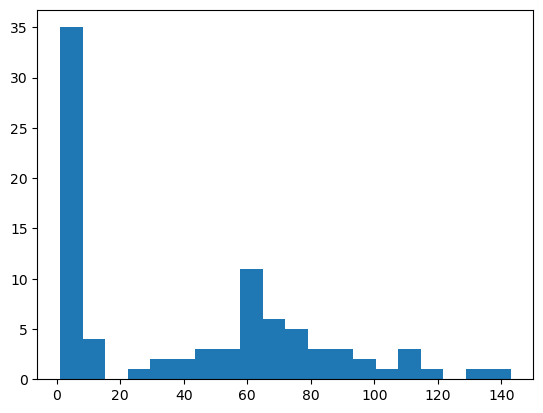

In [103]:
plt.hist(dataLen, bins = 20)
plt.show()

- 문장별 길이 일치시키기

In [105]:
# 기준 길이
MAX_LENGTH = max(dataLen)
MAX_LENGTH

143

In [108]:
# [1] 가장 긴  문장 길이 기준
for idx, sent in enumerate(encodingData) :
    cur_length = len(sent)
    if cur_length < MAX_LENGTH :
        encodingData[idx] = sent + [0]*(MAX_LENGTH - cur_length)        # 패딩

In [109]:
# 길이를 동일하게 잘 맞췄는지 확인
print(encodingData[0])
print(len(encodingData[0]))

[3, 2, 611, 135, 612, 3, 2, 135, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
143


In [111]:
# 길이를 동일하게 잘 맞췄는지 확인 2
for _ in encodingData[:3] :
    print(len(_), _)

143 [3, 2, 611, 135, 612, 3, 2, 135, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
143 [613, 614, 328, 92, 2, 45, 329, 4, 3, 76, 2, 330, 20, 331, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
143 [3, 7, 26, 215, 615, 616, 617, 618, 619, 620, 332, 333, 136, 137, 621, 46, 16, 9, 5, 622, 623, 2, 93, 13

<hr>

In [112]:
# 기준 길이
MAX_LENGTH = 100
MAX_LENGTH

100

In [113]:
# [2] 가장 긴  문장 길이 기준
for idx, sent in enumerate(encodingData) :
    cur_length = len(sent)
    if cur_length < MAX_LENGTH :
        encodingData[idx] = sent + [0]*(MAX_LENGTH - cur_length)
    else :
        # 길이가 100보다 긴 애들 자르기 - 앞부분을 자르는 경우
        encodingData[idx] = sent[(cur_length-MAX_LENGTH) :]

        # 뒷부분을 자르는 경우
        # encodingData[idx] = sent[:MAX_LENGTH]

In [118]:
for _ in encodingData :
    print(len(_))
    print(_)

100
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
100
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
100
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
100
[36, 339, 22, 634, 37, 11, 3, 12, 18, 6, 144, 635, 228, 340, 145, 0, 0, 0, 0, 0, 